# Set-up

In [425]:
# Basic imports
import pandas as pd
from tqdm.notebook import trange, tqdm
import os
from os.path import join

# Plotting imports
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.subplots as sp
import plotly.express as px
import plotly.graph_objects as go
import seaborn as sns

# Calendar imports
from datetime import datetime, timedelta
import calendar
import time
from workalendar.europe import Italy
import holidays

# Scraping imports
import requests
from urllib.error import HTTPError

# Geomedian imports
import numpy as np
from scipy.spatial.distance import cdist, euclidean

# FDA imports
import skfda
from skfda.exploratory.visualization import FPCAPlot
from skfda.preprocessing.dim_reduction import FPCA
from sklearn.metrics import pairwise_distances_argmin

# Statsmodels imports
import statsmodels.api as sm
from statsmodels.tsa.seasonal import STL

In [2]:
weekday_mapping = {
    0: "Monday",
    1: "Tuesday",
    2: "Wednesday",
    3: "Thursday",
    4: "Friday",
    5: "Saturday",
    6: "Sunday"
}

In [460]:
month_mapping = {
    1: 'January',
    2: 'February',
    3: 'March',
    4: 'April',
    5: 'May',
    6: 'June',
    7: 'July',
    8: 'August',
    9: 'September',
    10: 'October',
    11: 'November',
    12: 'December'
}

In [3]:
pd.options.mode.chained_assignment = None

# Functions

In [96]:
year_zone_system = {
    2018: 2012,
    2019: 2012,
    2020: 2012,
    2021: 2021,
    2022: 2021
}

In [4]:
def get_load_data(url, headers, date_from, date_to):
    """Gets Terna load data from date_from to date_to by making a get requests to url with headers"""
    params = {'dateFrom': date_from, 'dateTo': date_to}
    r = requests.get(url, headers=headers, params=params)
    if r.status_code != 200:
        print(r.text)
        r.raise_for_status()
    df = pd.DataFrame(r.json()['totalLoad'])
    return df

In [372]:
def get_string_color(color, opacity=1):
    r, g, b = tuple(int(value * 255) for value in color)
    return f'rgba({r}, {g}, {b}, {opacity})'

In [467]:
# Matplotlib 'cool' palette
cool_matplotlib = plt.cm.cool(range(256))

# Extract every 16th color to get a subset
subset_cool_matplotlib = cool_matplotlib[::256//11]

# Convert Matplotlib color format to Seaborn color format
cool_palette = sns.color_palette(subset_cool_matplotlib)
cool_palette

[(0.0, 1.0, 1.0),
 (0.09019607843137255, 0.9098039215686274, 1.0),
 (0.1803921568627451, 0.8196078431372549, 1.0),
 (0.27058823529411763, 0.7294117647058824, 1.0),
 (0.3607843137254902, 0.6392156862745098, 1.0),
 (0.45098039215686275, 0.5490196078431373, 1.0),
 (0.5411764705882353, 0.45882352941176474, 1.0),
 (0.6313725490196078, 0.3686274509803922, 1.0),
 (0.7215686274509804, 0.2784313725490196, 1.0),
 (0.8117647058823529, 0.18823529411764706, 1.0),
 (0.9019607843137255, 0.0980392156862745, 1.0),
 (0.9921568627450981, 0.007843137254901933, 1.0)]

In [391]:
deep_palette = sns.color_palette('deep')

In [393]:
def geometric_median(X, eps=1e-5):
    """
    Compute the geometric median of a set of points using an iterative algorithm.
    Taken from https://stackoverflow.com/questions/30299267/geometric-median-of-multidimensional-points (accepted answer)

    Parameters:
    - points: An array-like object containing the input points.
    - epsilon: Tolerance for convergence.

    Returns:
    - The geometric median point.
    """
    # Initialize the current estimate of the geometric median as the mean of the input points
    y = np.mean(X, 0)

    # Iteratively refine the estimate
    while True:
        # Compute the distances from each point to the current estimate
        D = cdist(X, [y])

        # Identify non-zero distances to avoid division by zero
        nonzeros = (D != 0)[:, 0]

        # Compute the inverse distances for non-zero elements
        Dinv = 1 / D[nonzeros]

        # Compute the sum of inverse distances
        Dinvs = np.sum(Dinv)

        # Compute weights based on inverse distances
        W = Dinv / Dinvs

        # Compute the weighted sum of points
        T = np.sum(W * X[nonzeros], 0)

        # Count the number of zero and non-zero distances
        num_zeros = len(X) - np.sum(nonzeros)

        # Update the estimate of the geometric median based on the number of zero distances
        if num_zeros == 0:
            y1 = T
        elif num_zeros == len(X):
            # If all distances are zero, the geometric median is found
            return y
        else:
            # Update the estimate using a weighted combination of the current estimate and the sum of points
            R = (T - y) * Dinvs
            r = np.linalg.norm(R)
            rinv = 0 if r == 0 else num_zeros / r
            y1 = max(0, 1 - rinv) * T + min(1, rinv) * y

        # Check for convergence based on Euclidean distance between current and updated estimates
        if euclidean(y, y1) < eps:
            return y1

        # Update the current estimate for the next iteration
        y = y1

In [433]:
def geometric_medoid(X, *kwargs):
    geomedian = geometric_median(X)
    argmin = pairwise_distances_argmin(np.array([geomedian]), X)[0]
    return X.iloc[argmin,:]

# Collect data

## Load data

### From API

In [148]:
# API account parameters
access_url = 'https://api.terna.it/transparency/oauth/accessToken'
API_KEY = '***REMOVED***'
SECRET = '***REMOVED***'
payload = f'grant_type=client_credentials&client_id={API_KEY}&client_secret={SECRET}'
access_headers = {'Content-Type': 'application/x-www-form-urlencoded'}

In [149]:
# Load endpoint URL and headers
url = 'https://api.terna.it/transparency/v1.0/gettotalload'
headers = {'Authorization': 'Bearer {}'.format(r_access.json()['access_token'])}

In [150]:
r_access = requests.post(access_url, headers=access_headers, data=payload)
r_access.raise_for_status()

time.sleep(1) # We need to sleep one second otherwise we get blocked
headers = {'Authorization': 'Bearer {}'.format(r_access.json()['access_token'])}

In [152]:
years = [2022, 2021, 2020, 2019, 2018]
months = range(1,13)

df_list = []

for year in tqdm(years):
    for month in tqdm(months):
        date_from = datetime(year, month, 1)
        _, days_in_month = calendar.monthrange(year, month)
        date_to = date_from + timedelta(days=days_in_month-1)
        date_from, date_to = date_from.strftime('%d/%m/%Y'), date_to.strftime('%d/%m/%Y')
        
        print(f"Fetching data from {date_from} to {date_to}...")
        try:
            time.sleep(1)
            df_list.append(get_load_data(url, headers, date_from, date_to))
        except Exception as e:
            print(e)
            r_access = requests.post(access_url, headers=access_headers, data=payload)
            headers = {'Authorization': 'Bearer {}'.format(r_access.json()['access_token'])}
            time.sleep(1)
            df_list.append(get_load_data(url, headers, date_from, date_to))     
print("Done")

df = pd.concat(df_list, ignore_index=True)
df

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/12 [00:00<?, ?it/s]

Fetching data from 01/01/2022 to 31/01/2022...
Fetching data from 01/02/2022 to 28/02/2022...
Fetching data from 01/03/2022 to 31/03/2022...
Fetching data from 01/04/2022 to 30/04/2022...
Fetching data from 01/05/2022 to 31/05/2022...
Fetching data from 01/06/2022 to 30/06/2022...
Fetching data from 01/07/2022 to 31/07/2022...
Fetching data from 01/08/2022 to 31/08/2022...
Fetching data from 01/09/2022 to 30/09/2022...
Fetching data from 01/10/2022 to 31/10/2022...
Fetching data from 01/11/2022 to 30/11/2022...
Fetching data from 01/12/2022 to 31/12/2022...


  0%|          | 0/12 [00:00<?, ?it/s]

Fetching data from 01/01/2021 to 31/01/2021...
Fetching data from 01/02/2021 to 28/02/2021...
Fetching data from 01/03/2021 to 31/03/2021...
Fetching data from 01/04/2021 to 30/04/2021...
Fetching data from 01/05/2021 to 31/05/2021...
Fetching data from 01/06/2021 to 30/06/2021...
Fetching data from 01/07/2021 to 31/07/2021...
Fetching data from 01/08/2021 to 31/08/2021...
Fetching data from 01/09/2021 to 30/09/2021...
Fetching data from 01/10/2021 to 31/10/2021...
Fetching data from 01/11/2021 to 30/11/2021...
Fetching data from 01/12/2021 to 31/12/2021...


  0%|          | 0/12 [00:00<?, ?it/s]

Fetching data from 01/01/2020 to 31/01/2020...
Fetching data from 01/02/2020 to 29/02/2020...
Fetching data from 01/03/2020 to 31/03/2020...
Fetching data from 01/04/2020 to 30/04/2020...
Fetching data from 01/05/2020 to 31/05/2020...
Fetching data from 01/06/2020 to 30/06/2020...
Fetching data from 01/07/2020 to 31/07/2020...
Fetching data from 01/08/2020 to 31/08/2020...
Fetching data from 01/09/2020 to 30/09/2020...
Fetching data from 01/10/2020 to 31/10/2020...
Fetching data from 01/11/2020 to 30/11/2020...
Fetching data from 01/12/2020 to 31/12/2020...


  0%|          | 0/12 [00:00<?, ?it/s]

Fetching data from 01/01/2019 to 31/01/2019...
Fetching data from 01/02/2019 to 28/02/2019...
Fetching data from 01/03/2019 to 31/03/2019...
Fetching data from 01/04/2019 to 30/04/2019...
Fetching data from 01/05/2019 to 31/05/2019...
Fetching data from 01/06/2019 to 30/06/2019...
Fetching data from 01/07/2019 to 31/07/2019...
Fetching data from 01/08/2019 to 31/08/2019...
Fetching data from 01/09/2019 to 30/09/2019...
Fetching data from 01/10/2019 to 31/10/2019...
Fetching data from 01/11/2019 to 30/11/2019...
Fetching data from 01/12/2019 to 31/12/2019...


  0%|          | 0/12 [00:00<?, ?it/s]

Fetching data from 01/01/2018 to 31/01/2018...
Fetching data from 01/02/2018 to 28/02/2018...
Fetching data from 01/03/2018 to 31/03/2018...
Fetching data from 01/04/2018 to 30/04/2018...
Fetching data from 01/05/2018 to 31/05/2018...
Fetching data from 01/06/2018 to 30/06/2018...
Fetching data from 01/07/2018 to 31/07/2018...
Fetching data from 01/08/2018 to 31/08/2018...
Fetching data from 01/09/2018 to 30/09/2018...
Fetching data from 01/10/2018 to 31/10/2018...
Fetching data from 01/11/2018 to 30/11/2018...
Fetching data from 01/12/2018 to 31/12/2018...
Done


,Date,Total_Load_MW,Forecast_Total_Load_MW,Bidding_Zone
0,2022-01-31 23:45:00,755.771,763.478,Calabria
1,2022-01-31 23:45:00,2776.003,2804.31,Centre-North
2,2022-01-31 23:45:00,5626.271,5683.643,Centre-South
3,2022-01-31 23:45:00,32852.002,33186.999,Italy
4,2022-01-31 23:45:00,18580.08,18769.545,North
...,...,...,...,...
1298646,2018-12-01 00:00:00,17497.08,18047.198,North
1298647,2018-12-01 00:00:00,31647,32642,Italy
1298648,2018-12-01 00:00:00,4175.268,4306.541,Centre-South
1298649,2018-12-01 00:00:00,3614.205,3727.838,Centre-North


In [153]:
df['Date'] = df.Date.astype('datetime64[ns]')
df = df[df.Date.dt.minute == 0] # The original granularity of the data is the hour and 15-min interval values are just interpolated
df['Total_Load_MW'] = df['Total_Load_MW'].astype(float)
df.drop('Forecast_Total_Load_MW', axis=1, inplace=True)
df.sort_values('Date', inplace=True)
df

,Date,Total_Load_MW,Bidding_Zone
1074201,2018-01-01 00:00:00,2653.638,Centre-North
1074200,2018-01-01 00:00:00,4468.169,Centre-South
1074199,2018-01-01 00:00:00,24743.000,Italy
1074198,2018-01-01 00:00:00,11662.759,North
1074197,2018-01-01 00:00:00,888.752,Sardinia
...,...,...,...
256539,2022-12-31 23:00:00,12808.302,North
256538,2022-12-31 23:00:00,602.691,Calabria
256537,2022-12-31 23:00:00,1877.409,South
256536,2022-12-31 23:00:00,859.379,Sardinia


In [211]:
# Check that there are no duplicates
check_dup = df.groupby(['Date', 'Bidding_Zone']).size()
check_dup[check_dup>1]

Date                 Bidding_Zone
2022-12-10 00:00:00  Calabria        2
                     Centre-North    2
                     Centre-South    2
                     Italy           2
                     North           2
                                    ..
2022-12-15 15:00:00  Italy           2
                     North           2
                     Sardinia        2
                     Sicily          2
                     South           2
Length: 384, dtype: int64

In [218]:
dup_dates = check_dup[check_dup>1].reset_index().Date.unique()
df[df.Date.isin(dup_dates)].sort_values(['Date', 'Bidding_Zone'])

,Date,Total_Load_MW,Bidding_Zone
320029,2022-12-10 00:00:00,581.927,Calabria
320033,2022-12-10 00:00:00,581.927,Calabria
320030,2022-12-10 00:00:00,2356.496,Centre-North
320035,2022-12-10 00:00:00,2356.496,Centre-North
320028,2022-12-10 00:00:00,5172.143,Centre-South
...,...,...,...
321495,2022-12-15 15:00:00,1102.626,Sardinia
321482,2022-12-15 15:00:00,2175.505,Sicily
321490,2022-12-15 15:00:00,2175.505,Sicily
321496,2022-12-15 15:00:00,2622.104,South


No idea on the origin of these duplicates, let's just drop them

In [219]:
df.drop_duplicates(inplace=True)
check_dup = df.groupby(['Date', 'Bidding_Zone']).size()
check_dup[check_dup>1]

Series([], dtype: int64)

In [225]:
df = df.pivot(columns='Bidding_Zone', values='Total_Load_MW', index='Date')
df

Bidding_Zone,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South
Date,,,,,,,,
2018-01-01 00:00:00,NaN,2653.638,4468.169,24743.000,11662.759,888.752,2083.771,2985.911
2018-01-01 01:00:00,NaN,2523.413,4277.290,23797.000,11567.556,827.743,1850.558,2750.440
2018-01-01 02:00:00,NaN,2389.800,4012.677,22175.999,10747.364,790.148,1750.474,2485.536
2018-01-01 03:00:00,NaN,2286.362,3719.836,21042.000,10229.732,791.042,1645.808,2369.220
2018-01-01 04:00:00,NaN,2211.796,3476.088,20146.999,9866.849,768.386,1536.844,2287.036
...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,772.670,2851.001,6384.130,33286.999,17174.376,1110.968,2450.546,2543.308
2022-12-31 20:00:00,769.930,2758.424,6170.830,31695.999,16116.553,1069.856,2373.797,2436.609
2022-12-31 21:00:00,700.313,2489.921,5546.548,28595.000,14652.883,974.200,2069.535,2161.600


In [226]:
df.to_csv('data/load.csv')

In [243]:
years = df.index.year.unique()
for year in tqdm(years):
    df[df.index.year == year].to_csv(f'data/load_{year}.csv')

  0%|          | 0/5 [00:00<?, ?it/s]

In [5]:
df = pd.read_csv('data/load.csv', index_col=[0], parse_dates=[0])
df

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South
Date,,,,,,,,
2018-01-01 00:00:00,NaN,2653.638,4468.169,24743.000,11662.759,888.752,2083.771,2985.911
2018-01-01 01:00:00,NaN,2523.413,4277.290,23797.000,11567.556,827.743,1850.558,2750.440
2018-01-01 02:00:00,NaN,2389.800,4012.677,22175.999,10747.364,790.148,1750.474,2485.536
2018-01-01 03:00:00,NaN,2286.362,3719.836,21042.000,10229.732,791.042,1645.808,2369.220
2018-01-01 04:00:00,NaN,2211.796,3476.088,20146.999,9866.849,768.386,1536.844,2287.036
...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,772.670,2851.001,6384.130,33286.999,17174.376,1110.968,2450.546,2543.308
2022-12-31 20:00:00,769.930,2758.424,6170.830,31695.999,16116.553,1069.856,2373.797,2436.609
2022-12-31 21:00:00,700.313,2489.921,5546.548,28595.000,14652.883,974.200,2069.535,2161.600


In [6]:
df

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South
Date,,,,,,,,
2018-01-01 00:00:00,NaN,2653.638,4468.169,24743.000,11662.759,888.752,2083.771,2985.911
2018-01-01 01:00:00,NaN,2523.413,4277.290,23797.000,11567.556,827.743,1850.558,2750.440
2018-01-01 02:00:00,NaN,2389.800,4012.677,22175.999,10747.364,790.148,1750.474,2485.536
2018-01-01 03:00:00,NaN,2286.362,3719.836,21042.000,10229.732,791.042,1645.808,2369.220
2018-01-01 04:00:00,NaN,2211.796,3476.088,20146.999,9866.849,768.386,1536.844,2287.036
...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,772.670,2851.001,6384.130,33286.999,17174.376,1110.968,2450.546,2543.308
2022-12-31 20:00:00,769.930,2758.424,6170.830,31695.999,16116.553,1069.856,2373.797,2436.609
2022-12-31 21:00:00,700.313,2489.921,5546.548,28595.000,14652.883,974.200,2069.535,2161.600


### From downloaded file

In [15]:
path = '/Users/guillaume/Documents/BSS/data.xlsx'

source_df = pd.read_excel(path)
source_df.head()

/Users/guillaume/bss/lib/python3.11/site-packages/openpyxl/styles/stylesheet.py:226: UserWarning:

Workbook contains no default style, apply openpyxl's default



,Date,Total Load [MW],Forecast Total load [MW],Bidding zone
0,2023-09-01 00:00:00,2650.742,2687.112,Centre-North
1,2023-09-01 00:00:00,4931.613,4999.278,Centre-South
2,2023-09-01 00:00:00,17225.567,17461.911,North
3,2023-09-01 00:00:00,906.052,918.484,Sardinia
4,2023-09-01 00:00:00,2150.859,2180.370,Sicily


In [16]:
source_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23042 entries, 0 to 23041
Data columns (total 4 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Date                      23041 non-null  object 
 1   Total Load [MW]           23040 non-null  float64
 2   Forecast Total load [MW]  23040 non-null  float64
 3   Bidding zone              23040 non-null  object 
dtypes: float64(2), object(2)
memory usage: 720.2+ KB


In [17]:
source_df['Date'].describe()

count                   23041
unique                   2881
top       2023-09-01 00:00:00
freq                        8
Name: Date, dtype: object

In [18]:
source_df['Bidding zone'].value_counts()

Bidding zone
Centre-North    2880
Centre-South    2880
North           2880
Sardinia        2880
Sicily          2880
South           2880
Calabria        2880
Italy           2880
Name: count, dtype: int64

In [19]:
df = source_df[source_df['Bidding zone']=='Italy']
df.head()

,Date,Total Load [MW],Forecast Total load [MW],Bidding zone
7,2023-09-01 00:00:00,31266.999,31696.000,Italy
15,2023-09-01 00:15:00,30617.999,30858.000,Italy
23,2023-09-01 00:30:00,30147.999,30443.000,Italy
31,2023-09-01 00:45:00,29781.000,29995.999,Italy
39,2023-09-01 01:00:00,29530.001,29640.001,Italy


## Consumption data

In [68]:
filenames = os.listdir('data/consumption')

cons_df_list = []

for name in sorted(filenames):
    year = int(name[:4])
    cons_df = pd.read_excel(join('data/consumption', name), skiprows=2)
    cons_df['year'] = year
    cons_df.drop('YoY settore', axis=1, inplace=True)
    cons_df_list.append(cons_df)

cons_df = pd.concat(cons_df_list, ignore_index=True)
cons_df

,Regione,Settore corretto,Sum of Consumo corretto,year
0,Veneto,Agricoltura,708.884874,2018
1,Veneto,Domestico,5595.518524,2018
2,Veneto,Industria,14741.332908,2018
3,Veneto,Servizi,9455.671888,2018
4,Valle d'Aosta,Agricoltura,5.323899,2018
...,...,...,...,...
395,Basilicata,Servizi,681.338094,2022
396,Abruzzo,Agricoltura,165.674637,2022
397,Abruzzo,Domestico,1258.266604,2022
398,Abruzzo,Industria,2788.733122,2022


In [102]:
# Read region zone mapping
region_zone = {}
for year in [2012, 2021]:
    region_zone_df = pd.read_excel('data/region_zone.xlsx', sheet_name=str(year))
    region_zone[year] = dict(zip(region_zone_df['Region'], region_zone_df['Zone']))
region_zone

{2012: {'Veneto': 'North',
  "Valle d'Aosta": 'North',
  'Umbria': 'Centre-North',
  'Trentino-Alto Adige': 'North',
  'Toscana': 'Centre-North',
  'Sicilia': 'Sicily',
  'Sardegna': 'Sardinia',
  'Puglia': 'South',
  'Piemonte': 'North',
  'Molise': 'South',
  'Marche': 'Centre-North',
  'Lombardia': 'North',
  'Liguria': 'North',
  'Lazio': 'Centre-South',
  'Friuli-Venezia Giulia': 'North',
  'Emilia-Romagna': 'North',
  'Campania': 'Centre-South',
  'Calabria': 'South',
  'Basilicata': 'South',
  'Abruzzo': 'Centre-South'},
 2021: {'Veneto': 'North',
  "Valle d'Aosta": 'North',
  'Umbria': 'Centre-South',
  'Trentino-Alto Adige': 'North',
  'Toscana': 'Centre-North',
  'Sicilia': 'Sicily',
  'Sardegna': 'Sardinia',
  'Puglia': 'South',
  'Piemonte': 'North',
  'Molise': 'South',
  'Marche': 'Centre-North',
  'Lombardia': 'North',
  'Liguria': 'North',
  'Lazio': 'Centre-South',
  'Friuli-Venezia Giulia': 'North',
  'Emilia-Romagna': 'North',
  'Campania': 'Centre-South',
  'Calabri

In [103]:
cons_df['Zone'] = cons_df.apply(lambda row: region_zone[year_zone_system[row.year]][row.Regione], axis=1)
cons_df

,Regione,Settore corretto,Sum of Consumo corretto,year,Zone
0,Veneto,Agricoltura,708.884874,2018,North
1,Veneto,Domestico,5595.518524,2018,North
2,Veneto,Industria,14741.332908,2018,North
3,Veneto,Servizi,9455.671888,2018,North
4,Valle d'Aosta,Agricoltura,5.323899,2018,North
...,...,...,...,...,...
395,Basilicata,Servizi,681.338094,2022,South
396,Abruzzo,Agricoltura,165.674637,2022,Centre-South
397,Abruzzo,Domestico,1258.266604,2022,Centre-South
398,Abruzzo,Industria,2788.733122,2022,Centre-South


In [105]:
cons_df.to_excel('data/consumption/consumption.xlsx', index=False)

# Exploration

## Global evolution over the whole time period

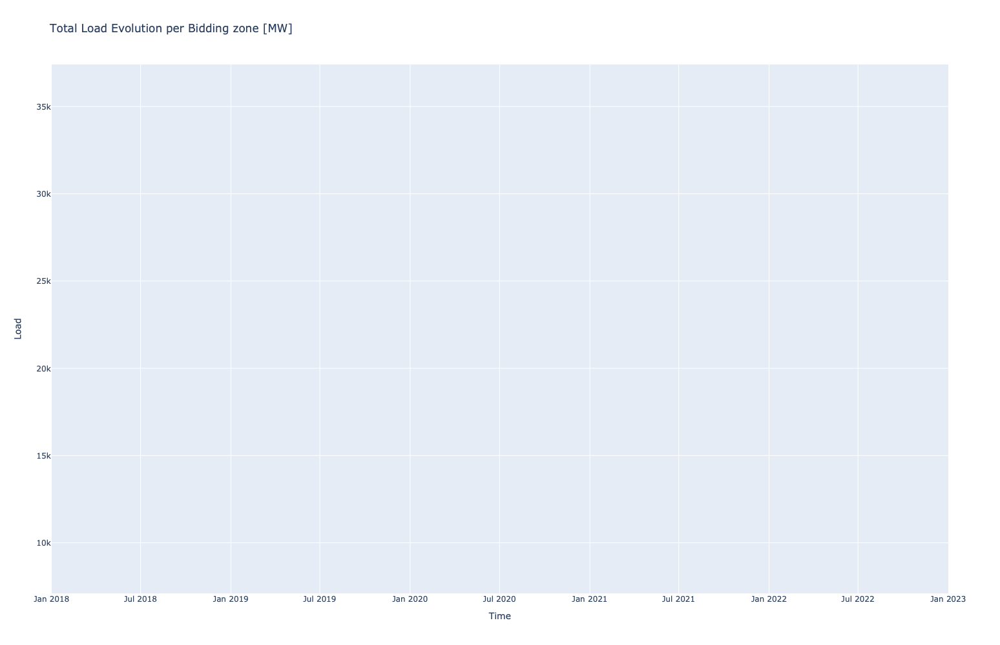

In [335]:
fig = px.line(
    df,
    x = df.index,
    y = 'North',
    #line_group='Bidding zone',
    title = 'Total Load Evolution per Bidding zone [MW]',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.show()

In [10]:
df

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South
Date,,,,,,,,
2018-01-01 00:00:00,NaN,2653.638,4468.169,24743.000,11662.759,888.752,2083.771,2985.911
2018-01-01 01:00:00,NaN,2523.413,4277.290,23797.000,11567.556,827.743,1850.558,2750.440
2018-01-01 02:00:00,NaN,2389.800,4012.677,22175.999,10747.364,790.148,1750.474,2485.536
2018-01-01 03:00:00,NaN,2286.362,3719.836,21042.000,10229.732,791.042,1645.808,2369.220
2018-01-01 04:00:00,NaN,2211.796,3476.088,20146.999,9866.849,768.386,1536.844,2287.036
...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,772.670,2851.001,6384.130,33286.999,17174.376,1110.968,2450.546,2543.308
2022-12-31 20:00:00,769.930,2758.424,6170.830,31695.999,16116.553,1069.856,2373.797,2436.609
2022-12-31 21:00:00,700.313,2489.921,5546.548,28595.000,14652.883,974.200,2069.535,2161.600


## Evolution of each year

In [16]:
df['year'] = df.index.year
df.head()

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year
Date,,,,,,,,,
2018-01-01 00:00:00,NaN,2653.638,4468.169,24743.000,11662.759,888.752,2083.771,2985.911,2018
2018-01-01 01:00:00,NaN,2523.413,4277.290,23797.000,11567.556,827.743,1850.558,2750.440,2018
2018-01-01 02:00:00,NaN,2389.800,4012.677,22175.999,10747.364,790.148,1750.474,2485.536,2018
2018-01-01 03:00:00,NaN,2286.362,3719.836,21042.000,10229.732,791.042,1645.808,2369.220,2018
2018-01-01 04:00:00,NaN,2211.796,3476.088,20146.999,9866.849,768.386,1536.844,2287.036,2018


In [18]:
df['month_day'] = df.index.to_series().apply(lambda d: d.replace(year=2020))
df.head()

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year,month_day
Date,,,,,,,,,,
2018-01-01 00:00:00,NaN,2653.638,4468.169,24743.000,11662.759,888.752,2083.771,2985.911,2018,2020-01-01 00:00:00
2018-01-01 01:00:00,NaN,2523.413,4277.290,23797.000,11567.556,827.743,1850.558,2750.440,2018,2020-01-01 01:00:00
2018-01-01 02:00:00,NaN,2389.800,4012.677,22175.999,10747.364,790.148,1750.474,2485.536,2018,2020-01-01 02:00:00
2018-01-01 03:00:00,NaN,2286.362,3719.836,21042.000,10229.732,791.042,1645.808,2369.220,2018,2020-01-01 03:00:00
2018-01-01 04:00:00,NaN,2211.796,3476.088,20146.999,9866.849,768.386,1536.844,2287.036,2018,2020-01-01 04:00:00


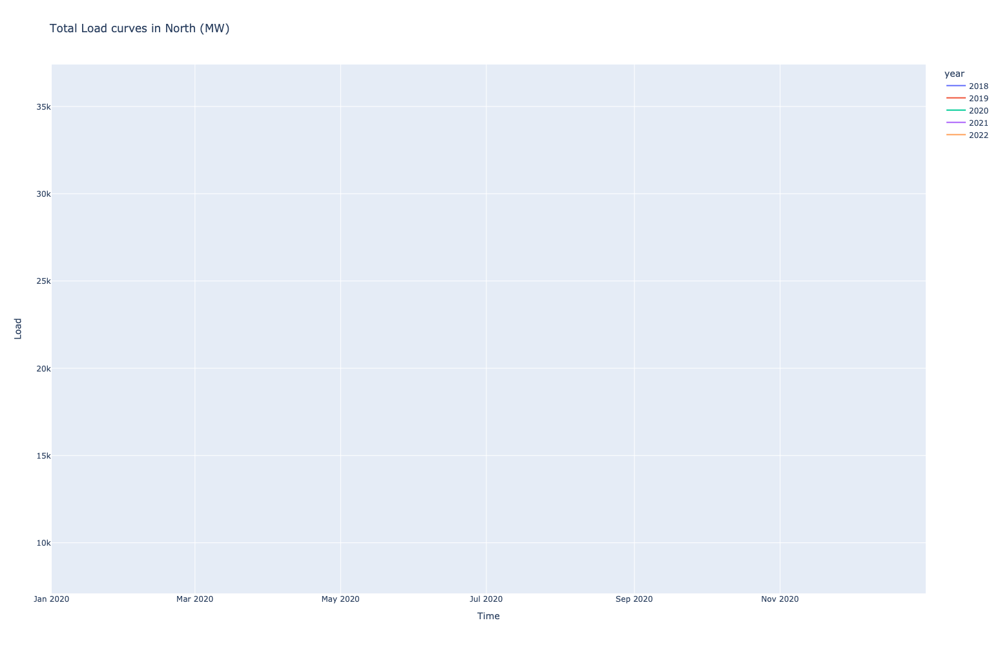

In [336]:
zone = 'North'
fig = px.line(
    df,
    x = 'month_day',
    y = zone,
    #line_group='Bidding zone',
    color = 'year',
    title = f'Total Load curves in {zone} (MW)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.show()

## Evolution of each day

In [27]:
df['day'] = df.index.date
df['time'] = df.index.to_series().apply(lambda d: d.replace(year=2020, month=1, day=1))
df['weekday'] = df.index.weekday.map(weekday_mapping)
df.head()

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year,month_day,day,time,weekday
Date,,,,,,,,,,,,,
2018-01-01 00:00:00,NaN,2653.638,4468.169,24743.000,11662.759,888.752,2083.771,2985.911,2018,2020-01-01 00:00:00,2018-01-01,2020-01-01 00:00:00,Monday
2018-01-01 01:00:00,NaN,2523.413,4277.290,23797.000,11567.556,827.743,1850.558,2750.440,2018,2020-01-01 01:00:00,2018-01-01,2020-01-01 01:00:00,Monday
2018-01-01 02:00:00,NaN,2389.800,4012.677,22175.999,10747.364,790.148,1750.474,2485.536,2018,2020-01-01 02:00:00,2018-01-01,2020-01-01 02:00:00,Monday
2018-01-01 03:00:00,NaN,2286.362,3719.836,21042.000,10229.732,791.042,1645.808,2369.220,2018,2020-01-01 03:00:00,2018-01-01,2020-01-01 03:00:00,Monday
2018-01-01 04:00:00,NaN,2211.796,3476.088,20146.999,9866.849,768.386,1536.844,2287.036,2018,2020-01-01 04:00:00,2018-01-01,2020-01-01 04:00:00,Monday


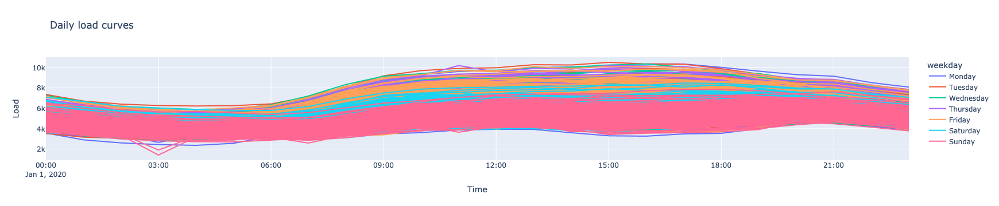

In [339]:
fig = px.line(
    df,
    x = 'time',
    y = 'Centre-South',
    line_group = 'day',
    color = 'weekday',
    title = 'Daily load curves',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.show()

## Each day of the week separately per zone

In [177]:
# Add hour
df['hour'] = df.index.hour

In [356]:
holidays_it = holidays.IT(years=df.year.unique())
for date, name in holidays_it.items():
    print(date, name)

2018-01-01 Capodanno
2018-01-06 Epifania del Signore
2018-04-01 Pasqua di Resurrezione
2018-04-02 Lunedì dell'Angelo
2018-04-25 Festa della Liberazione
2018-05-01 Festa dei Lavoratori
2018-06-02 Festa della Repubblica
2018-08-15 Assunzione della Vergine
2018-11-01 Tutti i Santi
2018-12-08 Immacolata Concezione
2018-12-25 Natale
2018-12-26 Santo Stefano
2019-01-01 Capodanno
2019-01-06 Epifania del Signore
2019-04-21 Pasqua di Resurrezione
2019-04-22 Lunedì dell'Angelo
2019-04-25 Festa della Liberazione
2019-05-01 Festa dei Lavoratori
2019-06-02 Festa della Repubblica
2019-08-15 Assunzione della Vergine
2019-11-01 Tutti i Santi
2019-12-08 Immacolata Concezione
2019-12-25 Natale
2019-12-26 Santo Stefano
2020-01-01 Capodanno
2020-01-06 Epifania del Signore
2020-04-12 Pasqua di Resurrezione
2020-04-13 Lunedì dell'Angelo
2020-04-25 Festa della Liberazione
2020-05-01 Festa dei Lavoratori
2020-06-02 Festa della Repubblica
2020-08-15 Assunzione della Vergine
2020-11-01 Tutti i Santi
2020-12-08 

In [357]:
df

,Calabria,Centre-North,Centre-South,Italy,North,Sardinia,Sicily,South,year,month_day,day,time,weekday,weekofyear,monthofyear,hour,daytype
Date,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,NaN,2653.638,4468.169,24743.000,11662.759,888.752,2083.771,2985.911,2018,2020-01-01 00:00:00,2018-01-01,2020-01-01 00:00:00,Monday,1,1,0,Holiday
2018-01-01 01:00:00,NaN,2523.413,4277.290,23797.000,11567.556,827.743,1850.558,2750.440,2018,2020-01-01 01:00:00,2018-01-01,2020-01-01 01:00:00,Monday,1,1,1,Holiday
2018-01-01 02:00:00,NaN,2389.800,4012.677,22175.999,10747.364,790.148,1750.474,2485.536,2018,2020-01-01 02:00:00,2018-01-01,2020-01-01 02:00:00,Monday,1,1,2,Holiday
2018-01-01 03:00:00,NaN,2286.362,3719.836,21042.000,10229.732,791.042,1645.808,2369.220,2018,2020-01-01 03:00:00,2018-01-01,2020-01-01 03:00:00,Monday,1,1,3,Holiday
2018-01-01 04:00:00,NaN,2211.796,3476.088,20146.999,9866.849,768.386,1536.844,2287.036,2018,2020-01-01 04:00:00,2018-01-01,2020-01-01 04:00:00,Monday,1,1,4,Holiday
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,772.670,2851.001,6384.130,33286.999,17174.376,1110.968,2450.546,2543.308,2022,2020-12-31 19:00:00,2022-12-31,2020-01-01 19:00:00,Saturday,52,12,19,Saturday
2022-12-31 20:00:00,769.930,2758.424,6170.830,31695.999,16116.553,1069.856,2373.797,2436.609,2022,2020-12-31 20:00:00,2022-12-31,2020-01-01 20:00:00,Saturday,52,12,20,Saturday
2022-12-31 21:00:00,700.313,2489.921,5546.548,28595.000,14652.883,974.200,2069.535,2161.600,2022,2020-12-31 21:00:00,2022-12-31,2020-01-01 21:00:00,Saturday,52,12,21,Saturday


In [446]:
df['daytype'] = 'Working day'
df.loc[df.weekday == 'Saturday', 'daytype'] = 'Saturday'
df.loc[df.weekday == 'Sunday', 'daytype'] = 'Sunday'
df.loc[df.day.apply(lambda day: day in holidays_it), 'daytype'] = 'Holiday'
df.daytype.value_counts()

daytype
Working day    30432
Saturday        6048
Sunday          5899
Holiday         1440
Name: count, dtype: int64

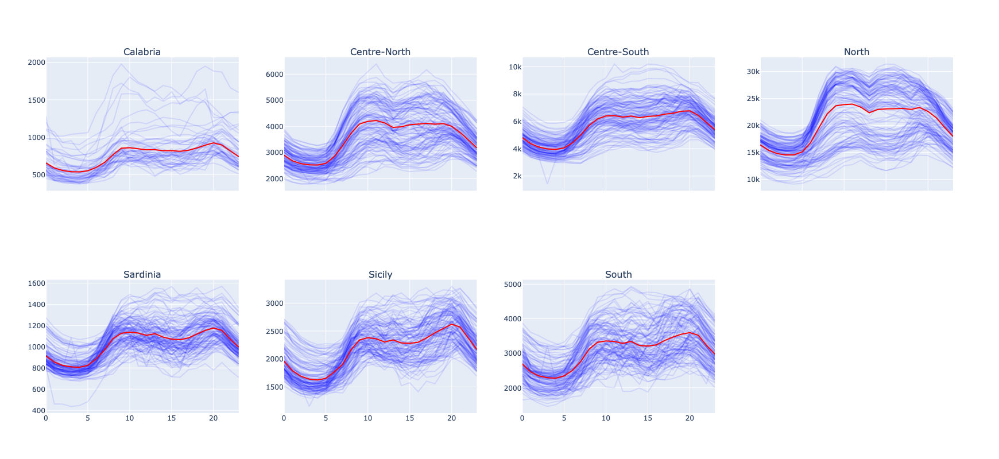

In [322]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

#select_condition = (df.monthofyear == 11)
select_condition = (df.monthofyear.isin(range(1,13)))

# Add px.line plots to each subplot

for i, col in enumerate(load_cols):
    for k, day in enumerate(df[select_condition].day.sample(frac=.003).unique()):
        if col != 'Calabria' or day.year > 2020:
            day_df = df[select_condition & (df.day == day)]
            fig.add_trace(go.Scatter(y=day_df[col], x=day_df['hour'], mode="lines", line=dict(color='rgba(0, 0, 255, 0.1)')), row=1+i//4, col=1+i%4)
    mean_df = df[select_condition].groupby('hour', as_index=False)[load_cols].mean()
    fig.add_trace(go.Scatter(y=mean_df[col], x=mean_df['hour'], mode="lines", line=dict(color='rgba(255, 0, 0, 1)')), row=1+i//4, col=1+i%4)
    fig.update_traces(showlegend=False)
    
    
#fig.add_trace(px.line(df1, x='year', y='gdpPercap', color='country').data[0], row=1, col=1)
#fig.add_trace(px.line(df2, x='year', y='gdpPercap', color='country').data[0], row=2, col=1)

# Update layout to adjust spacing
fig.update_layout(height=800, width=1500)

# Show the plot
fig.show()

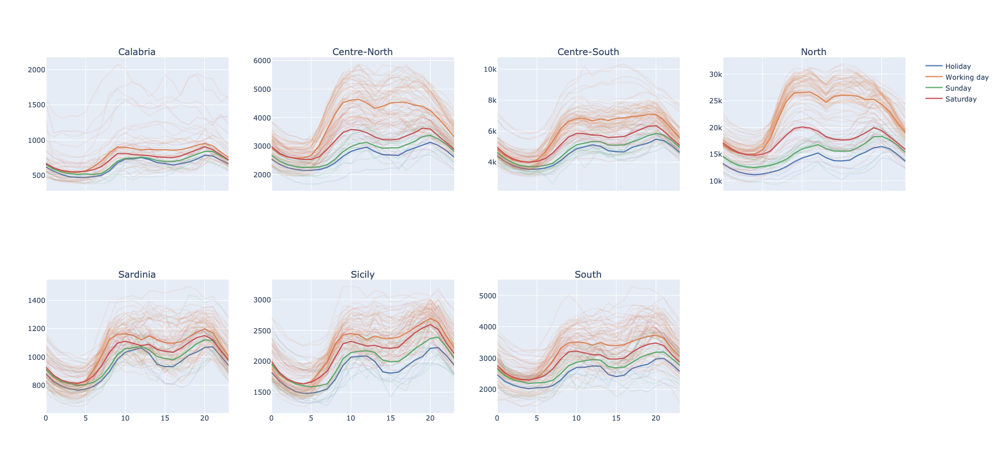

In [447]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

#select_condition = (df.monthofyear == 11)
select_condition = (df.monthofyear.isin(range(1,13)))

# For each region
for i, col in enumerate(load_cols):
    # For each type of day (Working day, Saturday, Sunday, Holiday)
    for j, daytype in enumerate(df.daytype.unique()):
        # We set the list of days to plot, subsampling for visibility
        days_to_plot = df[select_condition & (df.daytype == daytype)].day.drop_duplicates().sample(frac=0.05)
        # For each day to plot
        for k, day in enumerate(days_to_plot):
            if col != 'Calabria' or day.year > 2020: # Calabria region doesn't have data for year before 2021
                day_df = df[df.day == day]
                # Plotting the line for each single day
                fig.add_trace(
                    go.Scatter(
                        y = day_df[col],
                        x = day_df['hour'],
                        mode = "lines",
                        line = dict(color=get_string_color(deep_palette[j], opacity=0.1)),
                        showlegend = False
                    ),
                    row = 1+i//4,
                    col = 1+i%4
                )
        # Getting the mean curve
        mean_df = df[select_condition & (df.daytype == daytype)].groupby('hour', as_index=False)[col].mean()
        # Plotting the mean
        fig.add_trace(
            go.Scatter(
                y = mean_df[col],
                x = mean_df['hour'],
                mode = "lines",
                line = dict(color=get_string_color(deep_palette[j])),
                name = daytype,
                showlegend = (i == 0) # We plot the legend for the first one only
            ),
            row=1+i//4,
            col=1+i%4
        )


# Update layout to adjust spacing
fig.update_layout(height=800, width=1740)

# Show the plot
fig.show()

- Not so much difference between the Sunday and the Holidays so we decide to merge them together
- Saturday stay as a mixture between working days and holidays, so we keep it separated

In [448]:
df.loc[df.daytype == 'Sunday', 'daytype'] = 'Holiday'
df.daytype.value_counts()

daytype
Working day    30432
Holiday         7339
Saturday        6048
Name: count, dtype: int64

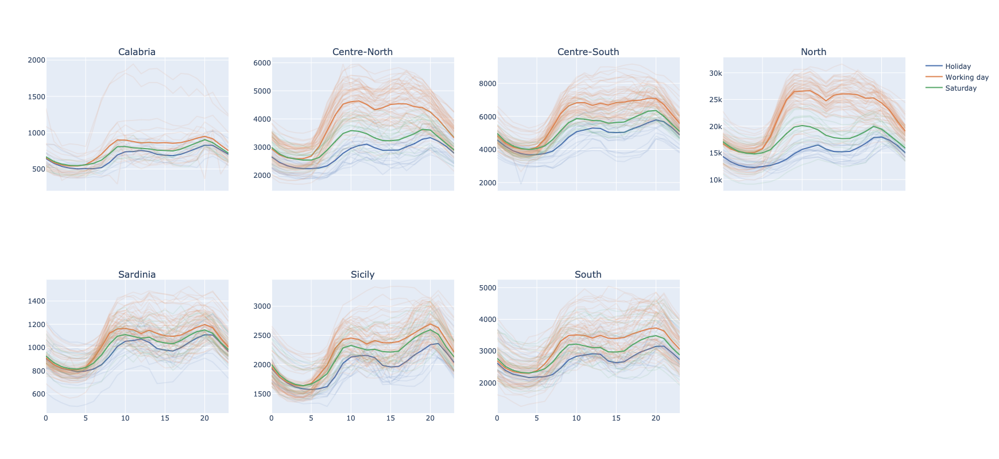

In [451]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

#select_condition = (df.monthofyear == 8)
select_condition = (df.monthofyear.isin(range(1,13)))

# For each region
for i, col in enumerate(load_cols):
    # For each type of day (Working day, Saturday, Sunday, Holiday)
    for j, daytype in enumerate(df.daytype.unique()):
        # We set the list of days to plot, subsampling for visibility
        days_to_plot = df[select_condition & (df.daytype == daytype)].day.drop_duplicates().sample(frac=0.05)
        # For each day to plot
        for k, day in enumerate(days_to_plot):
            if col != 'Calabria' or day.year > 2020: # Calabria region doesn't have data for year before 2021
                day_df = df[df.day == day]
                # Plotting the line for each single day
                fig.add_trace(
                    go.Scatter(
                        y = day_df[col],
                        x = day_df['hour'],
                        mode = "lines",
                        line = dict(color=get_string_color(deep_palette[j], opacity=0.1)),
                        showlegend = False
                    ),
                    row = 1+i//4,
                    col = 1+i%4
                )
        # Getting the mean curve
        mean_df = df[select_condition & (df.daytype == daytype)].groupby('hour', as_index=False)[col].mean()
        # Plotting the mean
        fig.add_trace(
            go.Scatter(
                y = mean_df[col],
                x = mean_df['hour'],
                mode = "lines",
                line = dict(color=get_string_color(deep_palette[j])),
                name = daytype,
                showlegend = (i == 0) # We plot the legend for the first one only
            ),
            row=1+i//4,
            col=1+i%4
        )


# Update layout to adjust spacing
fig.update_layout(height=800, width=1740)

# Show the plot
fig.show()

Plotting now the monthly evolution

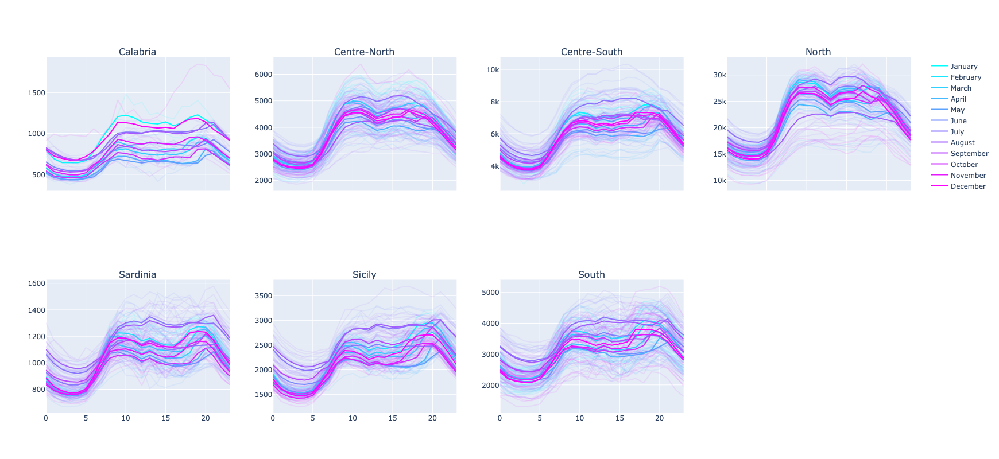

In [473]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

#select_condition = (df.monthofyear == 8)
select_condition = (df.monthofyear.isin(range(1,13))) & (df.daytype == 'Working day')

# For each region
for i, col in enumerate(load_cols):
    # For each type of day (Working day, Saturday, Sunday, Holiday)
    for j, month in enumerate(df.monthofyear.unique()):
        # We set the list of days to plot, subsampling for visibility
        days_to_plot = df[select_condition & (df.monthofyear == month)].day.drop_duplicates().sample(frac=0.1)
        # For each day to plot
        for k, day in enumerate(days_to_plot):
            if col != 'Calabria' or day.year > 2020: # Calabria region doesn't have data for year before 2021
                day_df = df[df.day == day]
                # Plotting the line for each single day
                fig.add_trace(
                    go.Scatter(
                        y = day_df[col],
                        x = day_df['hour'],
                        mode = "lines",
                        line = dict(color=get_string_color(cool_palette[j], opacity=0.1)),
                        showlegend = False
                    ),
                    row = 1+i//4,
                    col = 1+i%4
                )
        # Getting the mean curve
        mean_df = df[select_condition & (df.monthofyear == month)].groupby('hour', as_index=False)[col].mean()
        # Plotting the mean
        fig.add_trace(
            go.Scatter(
                y = mean_df[col],
                x = mean_df['hour'],
                mode = "lines",
                line = dict(color=get_string_color(cool_palette[j])),
                name = month_mapping[month],
                showlegend = (i == 0) # We plot the legend for the first one only
            ),
            row=1+i//4,
            col=1+i%4
        )


# Update layout to adjust spacing
fig.update_layout(height=800, width=1740)

# Show the plot
fig.show()

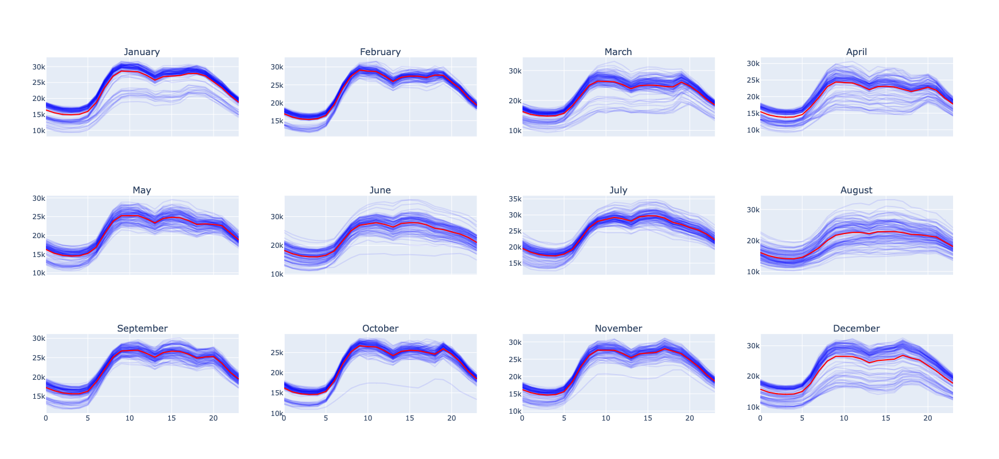

In [476]:
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=3, cols=4, shared_xaxes=True, subplot_titles=calendar.month_name[1:])

region = 'North'
select_condition = df.daytype == 'Working day'

# Add px.line plots to each subplot

for month in range(1,13):
    for k, day in enumerate(df[select_condition & (df.monthofyear==month)].day.unique()):
        if region != 'Calabria' or day.year > 2020:
            day_df = df[df.day == day]
            fig.add_trace(go.Scatter(y=day_df[region], x=day_df['hour'], mode="lines", line=dict(color='rgba(0, 0, 255, 0.1)')), row=1+(month-1)//4, col=1+(month-1)%4)
    mean_df = df[select_condition & (df.monthofyear==month)].groupby('hour', as_index=False)[region].mean()
    fig.add_trace(go.Scatter(y=mean_df[region], x=mean_df['hour'], mode="lines", line=dict(color='rgba(255, 0, 0, 1)')), row=1+(month-1)//4, col=1+(month-1)%4)
    fig.update_traces(showlegend=False)
    
    
#fig.add_trace(px.line(df1, x='year', y='gdpPercap', color='country').data[0], row=1, col=1)
#fig.add_trace(px.line(df2, x='year', y='gdpPercap', color='country').data[0], row=2, col=1)

# Update layout to adjust spacing
fig.update_layout(height=800, width=1500)

# Show the plot
fig.show()

## Normalizing the signals

In [325]:
load_cols = ['Calabria', 'Centre-North', 'Centre-South', 'North', 'Sardinia', 'Sicily', 'South']
df_scaled = df.copy()
df_scaled[load_cols+['Italy']] = df[load_cols+['Italy']].apply(lambda col: (col - col.mean()) / col.std())

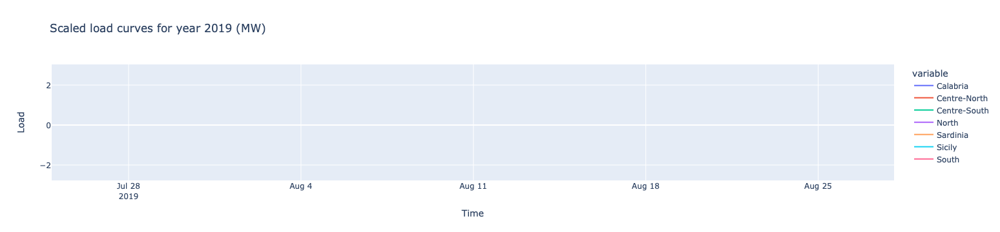

In [326]:
year = 2019

fig = px.line(
    df_scaled[df_scaled.year == year],
    x = df_scaled[df_scaled.year == year].index,
    y = load_cols,
    title = f'Scaled load curves for year {year} (MW)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.show()

## Up-scaling the signals

### Day-level

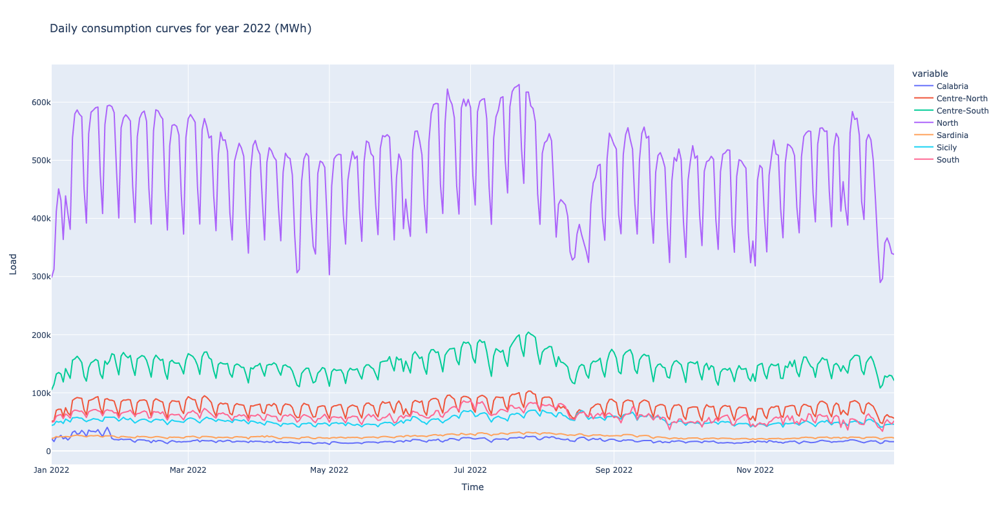

In [327]:
# Unnormalized
year = 2022
day_df = df.groupby('day')[load_cols].sum()
day_df = day_df[day_df.index.astype('datetime64[ns]').year == year]

fig = px.line(
    day_df,
    x = day_df.index,
    y = load_cols,
    title = f'Daily consumption curves for year {year} (MWh)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.update_layout(height=800, width=1500)
fig.show()

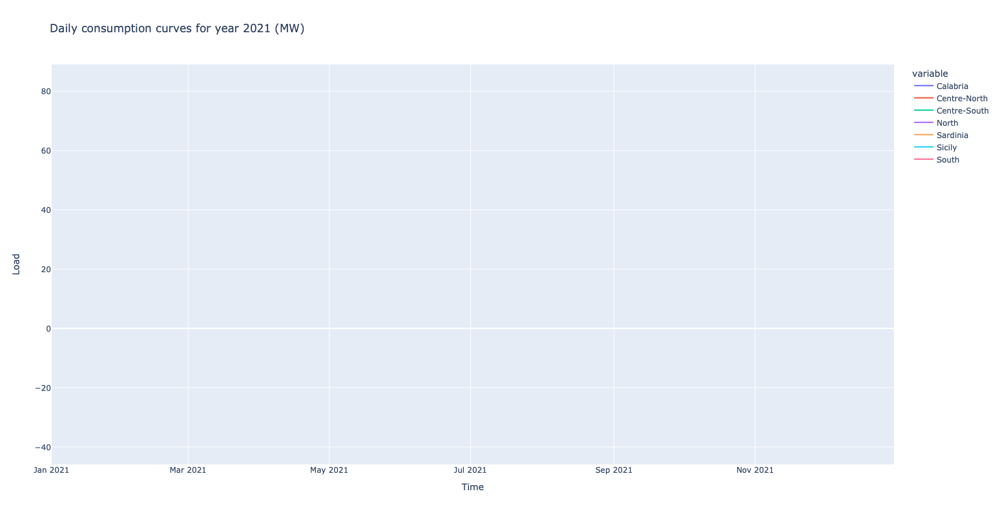

In [248]:
# Normalized
year = 2021
df_scaled['day'] = df['day']
day_df = df_scaled.groupby('day')[load_cols].sum()
day_df = day_df[day_df.index.astype('datetime64[ns]').year == year]

fig = px.line(
    day_df,
    x = day_df.index,
    y = load_cols,
    title = f'Daily consumption curves for year {year} (MW)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.update_layout(height=800, width=1500)
fig.show()

### Week-level

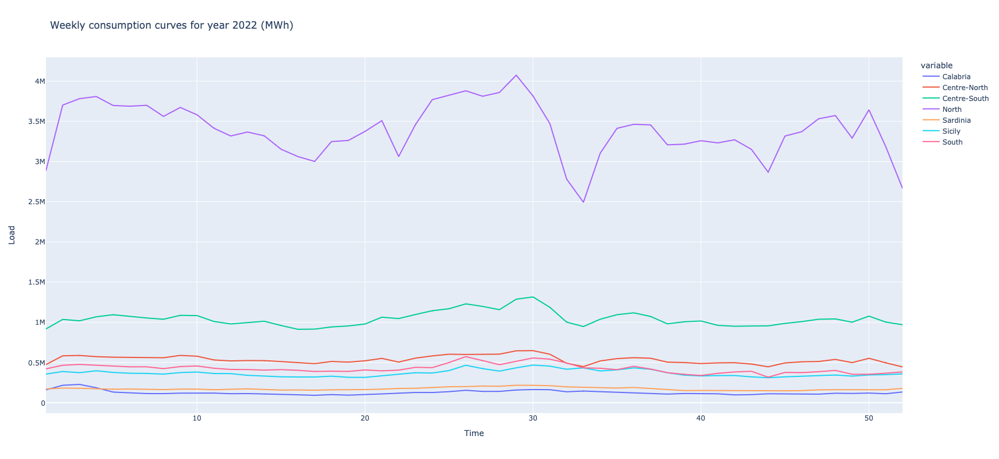

In [328]:
# Unnormalized
year = 2022
df['weekofyear'] = df.index.isocalendar().week
week_df = df.groupby(['year', 'weekofyear'], as_index=False)[load_cols].sum()
week_df = week_df[week_df.year == year]

fig = px.line(
    week_df,
    x = 'weekofyear',
    y = load_cols,
    title = f'Weekly consumption curves for year {year} (MWh)',
    height = 1000
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.update_layout(height=800, width=1500)
fig.show()

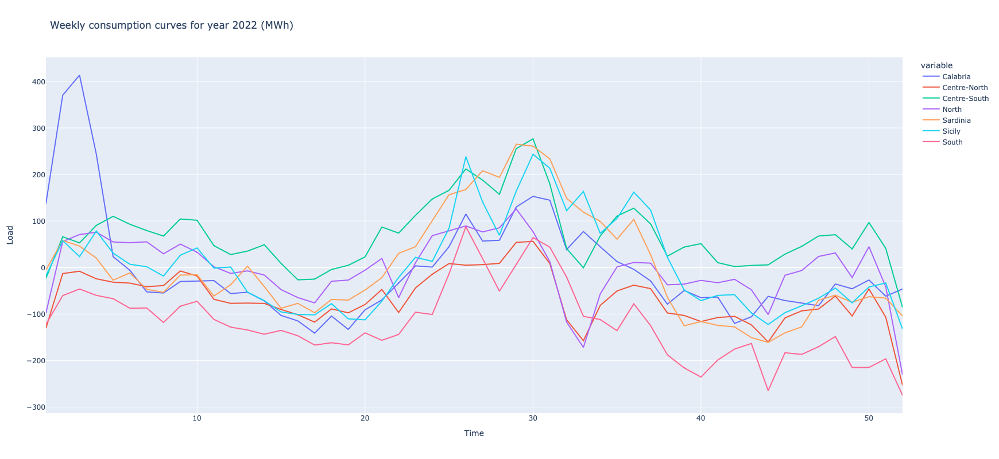

In [329]:
# Normalized
year = 2022
week_df = df_scaled.groupby(['year', 'weekofyear'], as_index=False)[load_cols].sum()
week_df = week_df[week_df.year == year]

fig = px.line(
    week_df,
    x = 'weekofyear',
    y = load_cols,
    title = f'Weekly consumption curves for year {year} (MWh)',
    height = 1000,
    line_shape = 'linear'
)

fig.update_xaxes(title_text='Time')
fig.update_yaxes(title_text='Load')
fig.update_layout(height=800, width=1500)
fig.show()

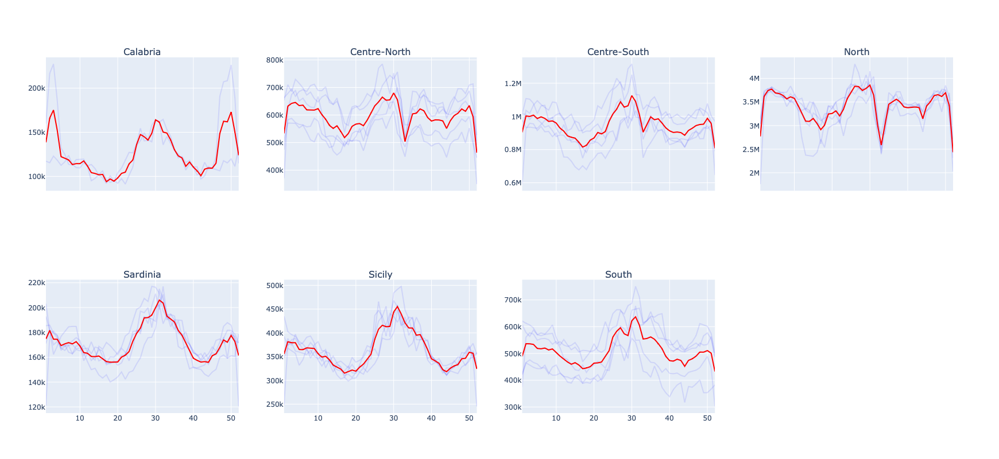

In [256]:
week_df = df[df.weekofyear<53].groupby(['year', 'weekofyear'], as_index=False)[load_cols].sum()
# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

# Add px.line plots to each subplot

for i, col in enumerate(load_cols):
    for k in range(week_df.year.nunique()):
        if col != 'Calabria' or k > 2:
            fig.add_trace(px.line(week_df, x='weekofyear', color_discrete_sequence=["rgba(0, 0, 255, 0.1)"], y=col, line_group='year').data[k], row=1+i//4, col=1+i%4)
    fig.add_trace(px.line(week_df.replace(0, np.nan).groupby('weekofyear', as_index=False)[load_cols].mean(),
                          x='weekofyear', y=col, color_discrete_sequence=["rgb(255, 0, 0)"]).data[0], row=1+i//4, col=1+i%4)
    
    
#fig.add_trace(px.line(df1, x='year', y='gdpPercap', color='country').data[0], row=1, col=1)
#fig.add_trace(px.line(df2, x='year', y='gdpPercap', color='country').data[0], row=2, col=1)

# Update layout to adjust spacing
fig.update_layout(height=800, width=1500)

# Show the plot
fig.show()

### Month-level

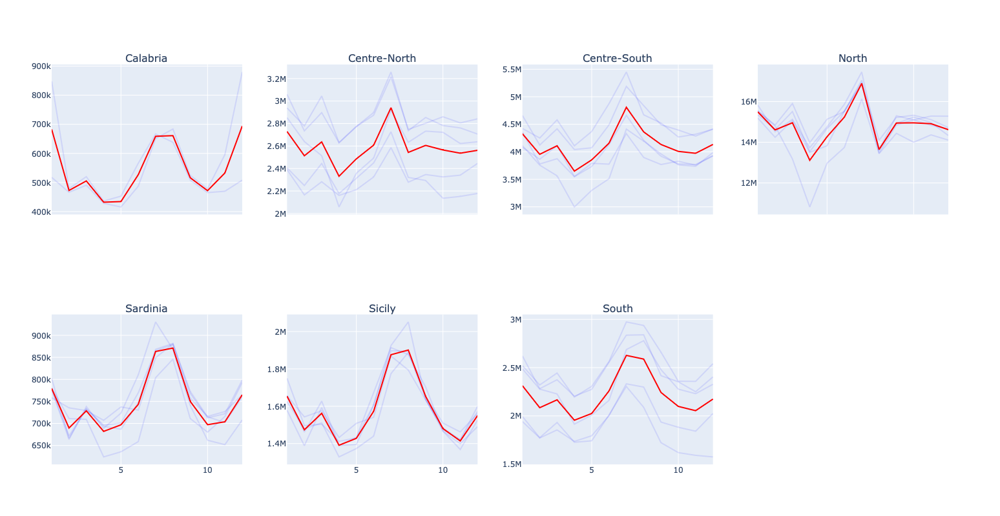

In [169]:
df['monthofyear'] = df.index.month
month_df = df.groupby(['year', 'monthofyear'], as_index=False)[load_cols].sum()

# Create subplots with two rows and one column
fig = sp.make_subplots(rows=2, cols=4, shared_xaxes=True, subplot_titles=load_cols)

# Add px.line plots to each subplot

for i, col in enumerate(load_cols):
    for k in range(month_df.year.nunique()):
        if col != 'Calabria' or k > 2:
            fig.add_trace(px.line(month_df, x='monthofyear', color_discrete_sequence=["rgba(0, 0, 255, 0.1)"], y=col, line_group='year').data[k], row=1+i//4, col=1+i%4)
    fig.add_trace(px.line(month_df.replace(0, np.nan).groupby('monthofyear', as_index=False)[load_cols].mean(),
                          x='monthofyear', y=col, color_discrete_sequence=["rgb(255, 0, 0)"]).data[0], row=1+i//4, col=1+i%4)
    
    
#fig.add_trace(px.line(df1, x='year', y='gdpPercap', color='country').data[0], row=1, col=1)
#fig.add_trace(px.line(df2, x='year', y='gdpPercap', color='country').data[0], row=2, col=1)

# Update layout to adjust spacing
fig.update_layout(height=800, width=1500)

# Show the plot
fig.show()

# Trend-seasonal decomposition

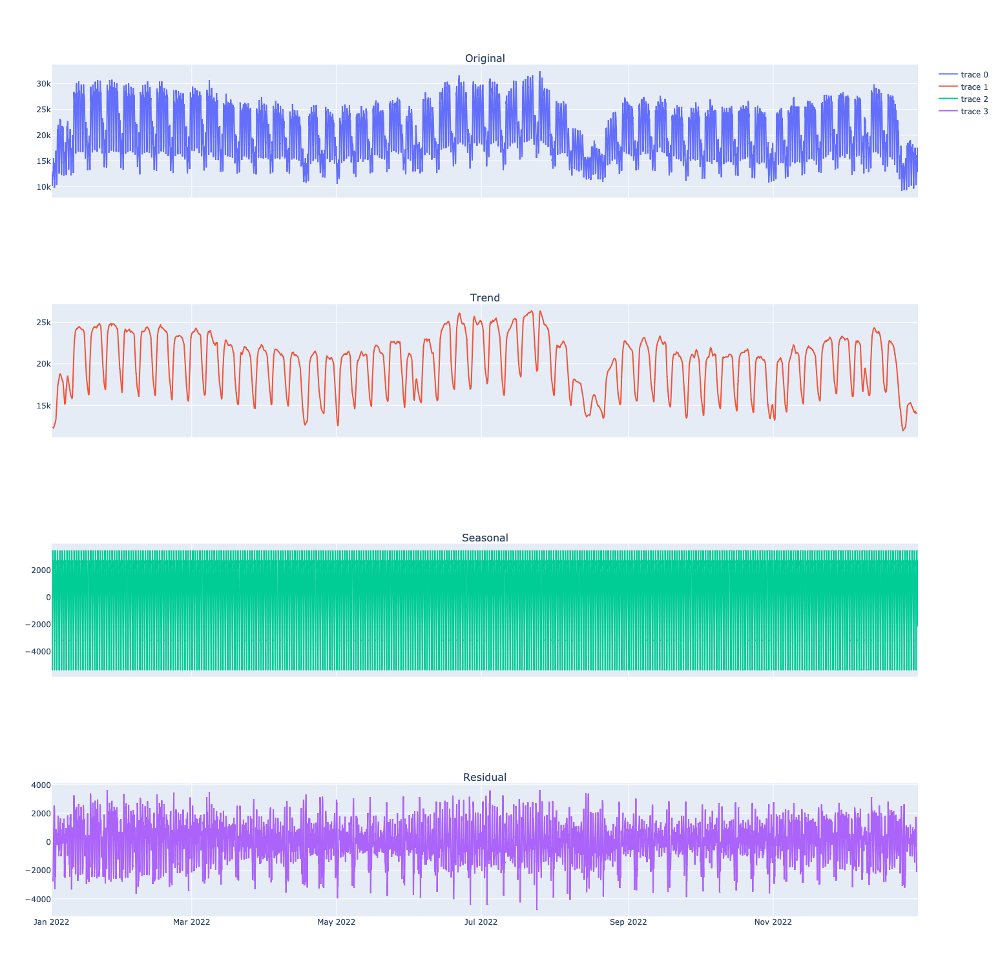

In [287]:
# Perform seasonal adjustment using STL decomposition
year = 2022
region = 'North'
ts = df.loc[df.index.year==year, region].asfreq('H')
ts.interpolate(limit=1, inplace=True)

result = sm.tsa.seasonal_decompose(ts)

# Plot the original, trend, seasonal, and residual components
fig = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, subplot_titles=['Original', 'Trend', 'Seasonal', 'Residual'])

fig.add_trace(
    go.Scatter(
        y=ts,
        x=ts.index,
        mode="lines",
    ),
    row=1,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.trend,
        x=ts.index,
        mode="lines",
    ),
    row=2,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.seasonal,
        x=ts.index,
        mode="lines",
    ),
    row=3,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.resid,
        x=ts.index,
        mode="lines",
    ),
    row=4,
    col=1
)

fig.update_layout(height=1500, width=1500)

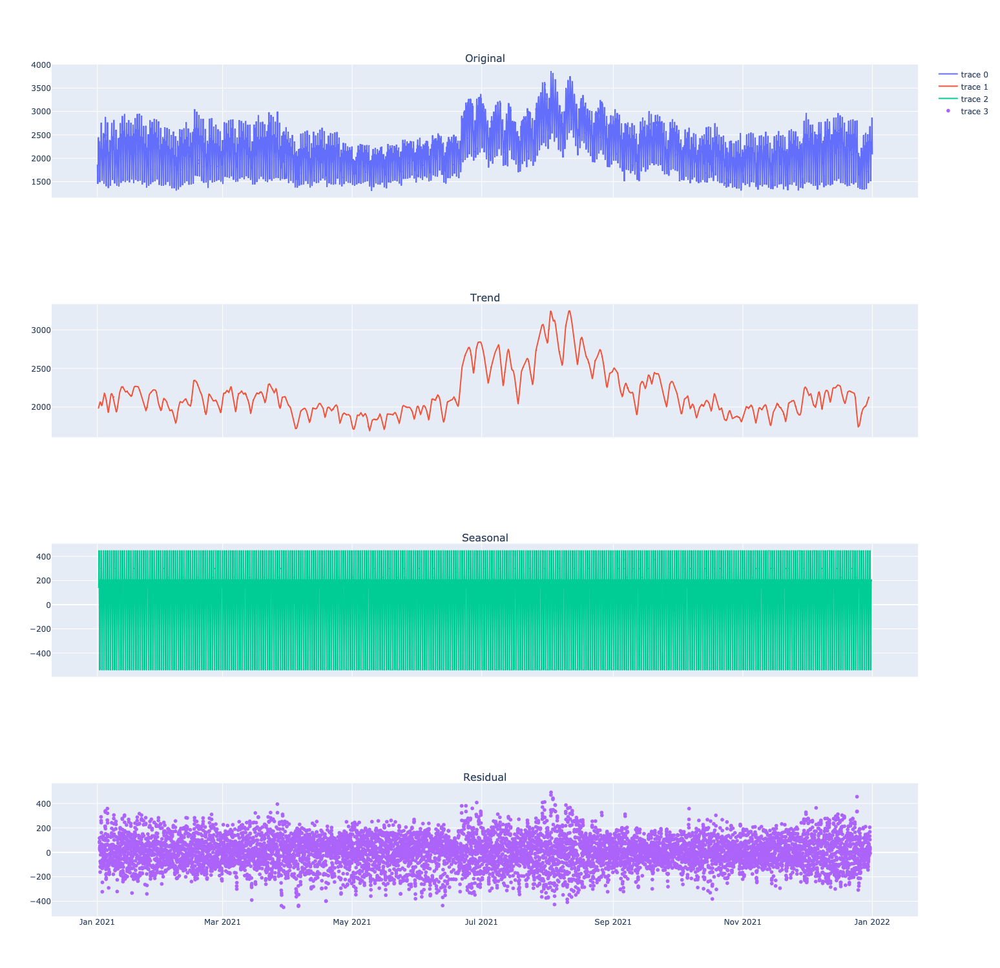

In [309]:
# Perform seasonal adjustment using STL decomposition
year = 2021
region = 'Sicily'
ts = df.loc[df.index.year==year, region].asfreq('H')
ts.interpolate(limit=1, inplace=True)

result = sm.tsa.seasonal_decompose(ts)

ts_new = result.trend

result2 = sm.tsa.seasonal_decompose(ts_new[~ts_new.isna()])

# Plot the original, trend, seasonal, and residual components
fig = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, subplot_titles=['Original', 'Trend', 'Seasonal', 'Residual'])

fig.add_trace(
    go.Scatter(
        y=ts,
        x=ts.index,
        mode="lines",
    ),
    row=1,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result2.trend,
        x=ts.index,
        mode="lines",
    ),
    row=2,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.seasonal+result2.seasonal,
        x=ts.index,
        mode="lines",
    ),
    row=3,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.resid+result2.resid,
        x=ts.index,
        mode="markers",
    ),
    row=4,
    col=1
)

fig.update_layout(height=1500, width=1500)

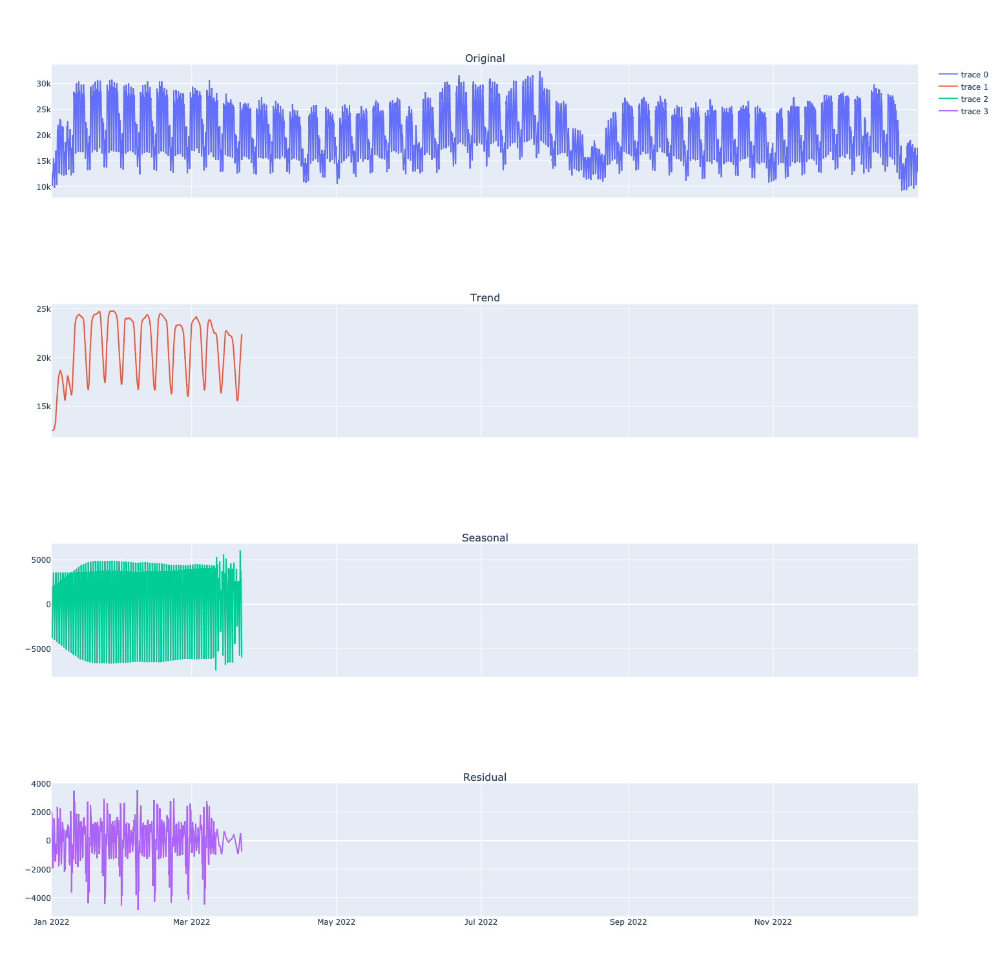

In [305]:
# Perform seasonal adjustment using STL decomposition
year = 2022
region = 'North'
ts = df.loc[df.index.year==year, region].asfreq('H')

stl = STL(ts.dropna().asfreq('H'), seasonal=25)
result = stl.fit()

ts_new = result.trend
result2 = STL(ts_new.dropna().asfreq('H'), seasonal=169).fit()

# Plot the original, trend, seasonal, and residual components
fig = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, subplot_titles=['Original', 'Trend', 'Seasonal', 'Residual'])

fig.add_trace(
    go.Scatter(
        y=ts,
        x=ts.index,
        mode="lines",
    ),
    row=1,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result2.trend,
        x=ts.index,
        mode="lines",
    ),
    row=2,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.seasonal+result2.seasonal,
        x=ts.index,
        mode="lines",
    ),
    row=3,
    col=1
)

fig.add_trace(
    go.Scatter(
        y=result.resid+result2.resid,
        x=ts.index,
        mode="lines",
    ),
    row=4,
    col=1
)

fig.update_layout(height=1500, width=1500)